# Optimisez la gestion des données d'une boutique avec R ou Python

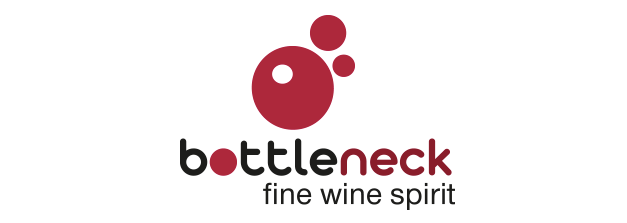

## Importation des modules
Commençons simplement par l'instalation des modules Pandas, Plotly . Qui me permettront respectivemment,
et entre autres choses de créer une base de données relationnelle, de créer des visualisations de ces données.


In [3]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)
import plotly.express as px


## Création de mes Dataframe

Pour cela rien de plus simple, j'utilise la méthode .read_excel() et je sauvegarde chaque Dataframe dans une variable.

In [4]:
web= pd.read_excel("web.xlsx")
erp= pd.read_excel("erp.xlsx")
liaison= pd.read_excel("liaison.xlsx")

Parfait mes dataframes sont créés ,  pour les voir il me suffit d' "appeler" les variables auxquelles je les ai associés. Je pourrais utiliser la méthode .head() sur chaque variables utilisons un boucle for.

In [5]:
csv= [web,erp,liaison]
string = ["web","erp","liaison"]
n=0
for i in csv:
    print("\n Ci-après, les cinq premières lignes du tableau '" +'\033[1m'+string[n]+ '\033[0m'+"'." )
    display(i.head())
    n+=1   


 Ci-après, les cinq premières lignes du tableau 'web'.


,sku,virtual,downloadable,rating_count,average_rating,total_sales,tax_status,tax_class,post_author,post_date,...,post_name,post_modified,post_modified_gmt,post_content_filtered,post_parent,guid,menu_order,post_type,post_mime_type,comment_count
0,bon-cadeau-25-euros,0,0,0,0.0,10.0,taxable,NaN,1.0,2018-06-01 13:53:46,...,bon-cadeau-de-25-euros,2018-06-01 14:13:57,2018-06-01 12:13:57,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
1,15298,0,0,0,0.0,6.0,taxable,NaN,2.0,2018-02-08 12:58:52,...,pierre-jean-villa-saint-joseph-preface-2018,2019-12-30 09:30:29,2019-12-30 08:30:29,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
2,15296,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-02-08 13:49:41,...,pierre-jean-villa-saint-joseph-tilde-2017,2019-12-21 09:00:17,2019-12-21 08:00:17,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
3,15300,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-02-08 14:08:36,...,pierre-jean-villa-croze-hermitage-accroche-coe...,2020-06-26 18:15:03,2020-06-26 16:15:03,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
4,19814,0,0,0,0.0,3.0,taxable,NaN,2.0,2018-02-09 14:01:05,...,pierre-jean-villa-igp-gamine-2018,2020-01-04 16:36:01,2020-01-04 15:36:01,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0



 Ci-après, les cinq premières lignes du tableau 'erp'.


,product_id,onsale_web,price,stock_quantity,stock_status
0,3847,1,24.2,0,outofstock
1,3849,1,34.3,0,outofstock
2,3850,1,20.8,0,outofstock
3,4032,1,14.1,0,outofstock
4,4039,1,46.0,0,outofstock



 Ci-après, les cinq premières lignes du tableau 'liaison'.


,product_id,id_web
0,3847,15298
1,3849,15296
2,3850,15300
3,4032,19814
4,4039,19815


# <u> I )Première mission : Rapprochement des exports "erp.xls" et "web.xlsx"</u>

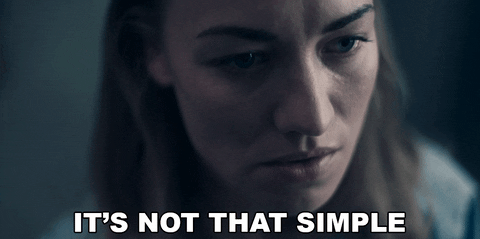

La première mission peut paraître **simple au premier abord**. Pour rapprocher les deux exports il suffit de **lier ces deux tableaux.** 
La mission semble d'autant plus aisée que, **Sylvie, a créé un tableau Excel qui permet d’établir le lien entre la référence du produit dans l’ERP (product_id) et la référence du même produit dans la base de la boutique en ligne (SKU)**.

Mais lier ces deux tableaux sans un travail préliminaire, serait une erreur.Le risque serait d'avoir un tableau disposant de bien trop de lignes, criblé de valeurs manquantes, de doublons, d'incohérences, de types de données innaproprié...
Avant de lier ces tableaux, il faudra malheureusement les nettoyer dans le but ici d'éviter d'avoir une analyse complétement faussée.


Tout d'abord, occupons nous de la ***petite erreur*** qu'à commis Sylvie dans le nommage d'une des colonnes de son tableau "liaison.xlsx".
**La colonne "id_web" dans son fichier correspond au "SKU" des produits dans la boutique en ligne**. Renommons cette colonne grace à la methode ***.rename()*** .

In [6]:
liaison.rename(columns={"id_web": "sku"},inplace= True)
liaison.head()
#liaison.isnull().sum()

,product_id,sku
0,3847,15298
1,3849,15296
2,3850,15300
3,4032,19814
4,4039,19815


Parfait ! **Le nom de la colonne a été changé**. Passons au nettoyage ! 


# A) <u> Nettoyage </u> 

## 1) <u> Nettoyage du tableau 'web'</u>

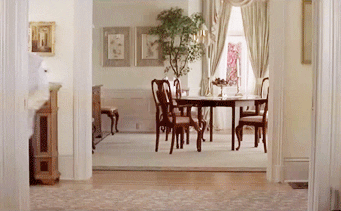

### a ) <u> Gestion des valeurs manquantes</u>

Commençons par nous occuper des **valeurs manquantes**. Une des façons de les mettre en valeur est d'utiliser les méthodes **.isnull()**.

In [7]:
web.isnull()

,sku,virtual,downloadable,rating_count,average_rating,total_sales,tax_status,tax_class,post_author,post_date,...,post_name,post_modified,post_modified_gmt,post_content_filtered,post_parent,guid,menu_order,post_type,post_mime_type,comment_count
0,False,False,False,False,False,False,False,True,False,False,...,False,False,False,True,False,False,False,False,True,False
1,False,False,False,False,False,False,False,True,False,False,...,False,False,False,True,False,False,False,False,True,False
2,False,False,False,False,False,False,False,True,False,False,...,False,False,False,True,False,False,False,False,True,False
3,False,False,False,False,False,False,False,True,False,False,...,False,False,False,True,False,False,False,False,True,False
4,False,False,False,False,False,False,False,True,False,False,...,False,False,False,True,False,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1508,False,False,False,False,False,False,True,True,False,False,...,False,False,False,True,False,False,False,False,False,False
1509,False,False,False,False,False,False,True,True,False,False,...,False,False,False,True,False,False,False,False,False,False
1510,False,False,False,False,False,False,True,True,False,False,...,False,False,False,True,False,False,False,False,False,False
1511,False,False,False,False,False,False,True,True,False,False,...,False,False,False,True,False,False,False,False,False,False


OK! Les resultats s'affichent sous forme de **valeurs booléennes**, mais c'est **complétement illisible**... Pour plus de practicalité associons la méthode **.isnull()** à **.sum()**.

In [8]:
web.isnull().sum()

sku                        85
virtual                     0
downloadable                0
rating_count                0
average_rating             83
total_sales                83
tax_status                797
tax_class                1513
post_author                83
post_date                  83
post_date_gmt              83
post_content             1513
post_title                 83
post_excerpt              797
post_status                83
comment_status             83
ping_status                83
post_password            1513
post_name                  83
post_modified              83
post_modified_gmt          83
post_content_filtered    1513
post_parent                83
guid                       83
menu_order                 83
post_type                  83
post_mime_type            799
comment_count              83
dtype: int64

L'association de ces deux méthodes à créer **un groupement des valeurs manquantes par colonnes**. Sans être exhaustif, on remarque par exemple qu'il y a :<ul>
<li>85 valeurs manquantes, dans la colonne SKU </li>
<li>797 valeurs manquantes, dans la colonne tax_status </li>
<li>1513 valeurs manquantes, dans les colonnes tax_class, post content, post_password et post_content_filtered</li>

L'objectif de cette ligne de code était de **deceler le nombre de valeurs manquantes par colonnes**. Maintenant que c'est fait, **est-on plus avancé ?** 
La réponse qui vient naturellement est : **non** .
Pourquoi cela ? Parce que gérer les valeurs manquantes c'est tout simplement **arbitrer**. C'est se demander s'il est judicieux de les supprimer. 
Et **pour arbitrer on a besoin d'un contexte**. Par exemple, de quoi parle t-on lorsqu'on parle de **"SKU"**, de **"tax_status"** ? Il y a **1513 valeurs manquantes** dans la colonnes **tax_class**, mais combien y a t-il de valeurs en tout ? 
C'est ce contexte qui nous permettra de décider **si oui ou non il convient de supprimer certaines lignes.** 

Première interrogation : Quelles sont les informations stockées dans le tableau **'web'** ?



Selon les mots de Laurent il s'agit d' "**un export d’une table de l’outil de CMS** contenant les informations des produits commercialisés en ligne **(nom, description, nombre de ventes...)**.
L’export issu de la boutique en ligne **contient le nombre de ventes pour chaque produit depuis sa mise en ligne, il ne permet pas d’analyser l'évolution des ventes dans le temps.**"

Il s'agit là de l'information la plus importante ce document ne permet pas d'analyser l'évolution des ventes dans le temps, **ce n'est qu'un registre contenant le nombre de vente pour chaque produit depuis sa mise en ligne**.


    

Deuxième interrogation : de quoi parle t-on lorsqu'on parle de "SKU" ? 

Le **SKU (Stock Keeping Unit)**, ou **UGS (Unité de Gestion de Stock)** est un code produit. En d'autres mots une clé **(primaire )** qui permet d'identifier les produits. 
Et là nous touchons quelques chose, car étant donné que SKU est une clé primaire, elle est indispensable et ne doit pas être manquante, or comme on l'a vu, il y 85 valeurs manquantes dans la colonnes SKU. 


In [9]:
web.isnull().sum()

sku                        85
virtual                     0
downloadable                0
rating_count                0
average_rating             83
total_sales                83
tax_status                797
tax_class                1513
post_author                83
post_date                  83
post_date_gmt              83
post_content             1513
post_title                 83
post_excerpt              797
post_status                83
comment_status             83
ping_status                83
post_password            1513
post_name                  83
post_modified              83
post_modified_gmt          83
post_content_filtered    1513
post_parent                83
guid                       83
menu_order                 83
post_type                  83
post_mime_type            799
comment_count              83
dtype: int64

**NB : on peut voir qu'il y a 85 SKU manquants mais qu'il y a 83 valeurs manquantes dans les colonnes:**
<ul>
<li>average_rating</li> 
<li>total_sales </li>
<li>post_author </li>
<li>post_date</li>
<li>post_date_gmt </li> 
<li>post_title</li>
<li>post_status</li>
<li>comment_status</li>
<li>ping_status</li>
<li>post_name</li>
<li>post_modified etc ... </li>                       
</ul>
Ce qui veut dire qu'il y a deux produit sans SKU. Je les stocke dans un dataframe **" produit_sans_SKU"** ci dessous. 


In [10]:
produit_sans_SKU = web.loc[(web['sku'].isnull()) & (web["post_name"].notnull())]
produit_sans_SKU

,sku,virtual,downloadable,rating_count,average_rating,total_sales,tax_status,tax_class,post_author,post_date,...,post_name,post_modified,post_modified_gmt,post_content_filtered,post_parent,guid,menu_order,post_type,post_mime_type,comment_count
470,NaN,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-07-31 12:07:23,...,pierre-jean-villa-cote-rotie-fongeant-2017,2019-11-02 13:24:15,2019-11-02 12:24:15,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
471,NaN,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-08-08 11:23:43,...,pierre-jean-villa-condrieu-suspendu-2018,2019-11-02 13:24:01,2019-11-02 12:24:01,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0


Avant de supprimer les lignes correspondantes à un SKU manquants utlisons la methode .**shape()** afin de savoir de combien de ligne et de colonne est composé notre dataframe.

In [11]:
web.shape

(1513, 28)

Le tableau web est composé de 1513 lignes est 28 colonnes. procédons maintenant à la suppression des lignes correspondantes à un SKU manquants grace à la méthode **.dropna()**

In [12]:
web.dropna(subset=['sku'], inplace=True)
web.shape

(1428, 28)

Est-ce qu'une autre d'autres lignes devraient être effacées ? Non, il faut garder tout les SKU dont on dispose, même si on peut s'interroger sur l'utilité réelle de colonnes vides.

### b ) <u> Gestion des doublons</u>

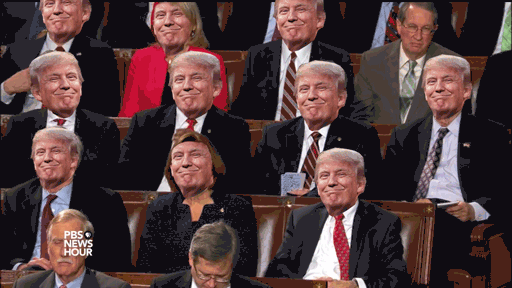

Comme nous l'avons expliqué, le SKU joue le rôle d'une **clé primaire**. Elle permet dès lors d'identfier les produits de façons à ce qu'à un produit soit associé une clé.
La prochaine étape du nettoyage consiste à s'assurer, qu'étant donné qu'il s'agit d'un registre contenant le nombre de vente pour chaque produit depuis sa mise en ligne, il n'y ait **pas de doublons** dans notre fichier. Auquel cas, il faudrait les supprimer. 
Pour déceler les doublons nous pouvons utiliser la methode **.duplicated()** que nous associerons à la méthode .sum() comme dans le point précédent.




In [13]:
web["sku"].duplicated().sum() # Somme des doublons dans la colonne "sku" du dataframe web.

714

Il y a 714 doublons dans notre fichier, ce qui fait beaucoup. On pourrait les supprimer sans aucune forme de procès, mais on pourrait aussi voir si derrière ces doublons se cache une articulation particulière. 

In [14]:
web.sort_values(["post_date"],ascending=True).head(8)

,sku,virtual,downloadable,rating_count,average_rating,total_sales,tax_status,tax_class,post_author,post_date,...,post_name,post_modified,post_modified_gmt,post_content_filtered,post_parent,guid,menu_order,post_type,post_mime_type,comment_count
1,15298,0,0,0,0.0,6.0,taxable,NaN,2.0,2018-02-08 12:58:52,...,pierre-jean-villa-saint-joseph-preface-2018,2019-12-30 09:30:29,2019-12-30 08:30:29,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
799,15298,0,0,0,0.0,6.0,NaN,NaN,2.0,2018-02-08 12:58:52,...,pierre-jean-villa-saint-joseph-preface-2018,2019-12-30 09:30:29,2019-12-30 08:30:29,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/...,0.0,attachment,image/jpeg,0.0
800,15296,0,0,0,0.0,0.0,NaN,NaN,2.0,2018-02-08 13:49:41,...,pierre-jean-villa-saint-joseph-tilde-2017,2019-12-21 09:00:17,2019-12-21 08:00:17,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/...,0.0,attachment,image/jpeg,0.0
2,15296,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-02-08 13:49:41,...,pierre-jean-villa-saint-joseph-tilde-2017,2019-12-21 09:00:17,2019-12-21 08:00:17,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
801,15300,0,0,0,0.0,0.0,NaN,NaN,2.0,2018-02-08 14:08:36,...,pierre-jean-villa-croze-hermitage-accroche-coe...,2020-06-26 18:15:03,2020-06-26 16:15:03,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/...,0.0,attachment,image/jpeg,0.0
3,15300,0,0,0,0.0,0.0,taxable,NaN,2.0,2018-02-08 14:08:36,...,pierre-jean-villa-croze-hermitage-accroche-coe...,2020-06-26 18:15:03,2020-06-26 16:15:03,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
4,19814,0,0,0,0.0,3.0,taxable,NaN,2.0,2018-02-09 14:01:05,...,pierre-jean-villa-igp-gamine-2018,2020-01-04 16:36:01,2020-01-04 15:36:01,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&...,0.0,product,NaN,0.0
802,19814,0,0,0,0.0,3.0,NaN,NaN,2.0,2018-02-09 14:01:05,...,pierre-jean-villa-igp-gamine-2018,2020-01-04 16:36:01,2020-01-04 15:36:01,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/...,0.0,attachment,image/jpeg,0.0


En choisissant de classer les rangées par date, on se rend vite compte de pourquoi il y a des doublons . 
Chaque fois qu'une personne met en ligne un produit sur le CMS avec une image, **deux lignes se créees et se superposent, celle avec un "post_type" product, et celle avec un "post_type" attachment.** 
Cette clarification nous permet d'utiliser la methode **.drop()** avec comme paramètre de séléction : les colonnes où **post_type** correspond à attachment

In [15]:
web.drop(web[web.post_type=='attachment'].index, inplace=True)
web.shape

(714, 28)

Après un **.shape**,  on peut se rendre compte que les documents a été tronqué d'environ la moitié de ses lignes. 

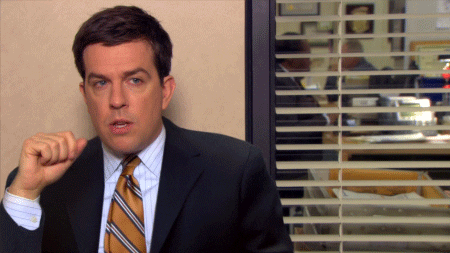

### c ) <u> Gestion des types de données</u>

C'est peut-être la chose par laquelle nous aurions dû commencer, mais étant donné que c'est l'étape la moins palpitante, à mon goût, c'est celle par laquelle je terminerai : La gestion des types de données. 
Dans le language Python presque tout est un objet et ces objets ont des types : on peut avoir des chaines de caractères ou string, des décimaux ou float, des nombre entiers ou int.
Et vérifier que chaque colonne et bien associée au bon type est primordiale pour la compréhension des données . Par exemple : on pourrait etre tenté de se dire que le SKU pourrait prendre le type int., mais ce serait faux par ce que le SKU est une variable qualitatve et non pas quantitative ( c'est une clé. Elle joue un rôle dans la qualification du produit ).
Pour faire apparaitre les types de données on utilise la méthode .dtypes.

In [16]:
web.dtypes

sku                              object
virtual                           int64
downloadable                      int64
rating_count                      int64
average_rating                  float64
total_sales                     float64
tax_status                       object
tax_class                       float64
post_author                     float64
post_date                datetime64[ns]
post_date_gmt            datetime64[ns]
post_content                    float64
post_title                       object
post_excerpt                     object
post_status                      object
comment_status                   object
ping_status                      object
post_password                   float64
post_name                        object
post_modified            datetime64[ns]
post_modified_gmt        datetime64[ns]
post_content_filtered           float64
post_parent                     float64
guid                             object
menu_order                      float64


Parfait ! Il semblerait qu'il n'y ait rien à faire de se côté,  on peut voir que le SKU est bien de type object, les dates sont de type datetime64[ns] Aux valeurs prenant la forme de décimales est bien associé un type float etc...

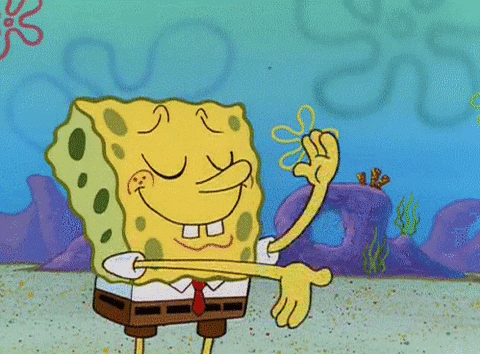

## 2) <u> Nettoyage du tableau 'erp'</u>

### a ) <u> Gestion des types de données</u>

Comme dans le point précédent utilisons la methode .dtypes afin de faire apparaitre les types de données de chaque colonne.

In [17]:
erp.dtypes

product_id          int64
onsale_web          int64
price             float64
stock_quantity      int64
stock_status       object
dtype: object

Que pouvons nous voir ? On remarque que le type de product_id est un integer alors qu'il s'agit d'une variable qualitative.  Je dois la modifier pour la mettre en object ou category.

In [18]:
erp["product_id"]=erp["product_id"].astype("object")
erp.dtypes

product_id         object
onsale_web          int64
price             float64
stock_quantity      int64
stock_status       object
dtype: object

Parfait ! Le type de product_id a été modifié.

### b ) <u> Gestion des valeurs manquantes</u>

In [19]:
erp.shape

(825, 5)

Un .shape nous permet de savoir que le tableau est composé de 825 lignes et de 5 colonnes.

Comme dans le point précédent utilisons les methodes .isnull() et .sum() afin de faire apparaitre les valeurs manquantes de chaque colonne.

In [20]:
erp.isnull().sum()

product_id        0
onsale_web        0
price             0
stock_quantity    0
stock_status      0
dtype: int64

C'est simple, il n'y en pas, passon à l'étape suivante .

### c ) <u> Gestion des doublons</u>

Comme dans le point précédent utilisons les methodes .duplicated() et .sum() afin de faire apparaitre les doublons.

In [21]:
erp.duplicated().sum()

0

Il n'y en a pas non plus 

### d ) <u> Gestion des incohérences</u>

Cette étape s'interesse à la relation entre deux colonnes . Celle  " stock_status" et "stock_quantity", il serait incohérent que la colonne stock_quantity fasse apparaitre le chiffre 0 et un stock_status instock et inversement. c'est ce que nous allons vérifier .

In [22]:
erp.loc[(erp["stock_status"]=="outofstock") & (erp["stock_quantity"]!=0)]
#recherche de couple ou stock_status correspond à outofstock et ou la quantité en stock est différnte de 0.

,product_id,onsale_web,price,stock_quantity,stock_status


Très bien on remarque qu'aucun résultat ne va dans ce sens !

In [23]:
erp.loc[(erp["stock_status"]=="instock") & (erp["stock_quantity"]==0)]
# recherche de couple ou stock_status correspond à instock et ou la quantité en stock est égale à 0.

,product_id,onsale_web,price,stock_quantity,stock_status
443,4954,1,25.0,0,instock


Ici c'est le cas, le produit 4954  affiche en stock alors que c'est faux .

## 3) <u> Nettoyage du tableau 'liaison'</u>

### a ) <u> Gestion des types de données</u>

Comme dans le point précédent utilisons la methode .dtypes afin de faire apparaitre les types de données de chaque colonne.

In [24]:
liaison.dtypes

product_id     int64
sku           object
dtype: object

Que pouvons nous voir ? On remarque que le type de product_id est un integer alors qu'il s'agit d'une variable qualitative. Je dois la modifier pour la mettre en object ou category.

In [25]:
liaison["product_id"]=liaison["product_id"].astype("object")
liaison.dtypes

product_id    object
sku           object
dtype: object

Parfait ! Le type de product_id a été modifié.

### b ) <u> Gestion des doublons</u>

Comme dans le point précédent utilisons les methodes .duplicated() et .sum() afin de faire apparaitre les doublons.

In [26]:
liaison.duplicated().sum()

0

Parfait ! Il n'y en a pas !

### c ) <u> Gestion des valeurs manquantes</u>

In [27]:
liaison.shape

(825, 2)

Un .shape nous permet de savoir que le tableau est composé de 825 lignes et de 2 colonnes.

Comme dans le point précédent utilisons les methodes .isnull() et .sum() afin de faire apparaitre les valeurs manquantes de chaque colonne.

In [28]:
liaison.isnull().sum()

product_id     0
sku           91
dtype: int64

La combinaison des méthode fait apparaitre 91 valeurs manquantes dans la colonne sku, et aucune valeurs manquantes dans la colonne product_id. 
La question qui se révèlent être judicieuse de se poser est de savoir si on doit supprimer les lignes où apparaissent un sku manquant . 
Et la réponses est non. Pourquoi ? Parce que la colonne **produit_id** est aussi une colonne faisant référence à des clés primaires : celles du tableau **erp**.
Je traiterai de ce point plus en détail dans la partie concernant les jointures. 
Sauvegardons tout de même ces valeurs sans SKU dans une variable.

In [29]:
produit_sans_SKU_liaison = liaison.loc[(liaison['sku'].isnull()) & (liaison["product_id"].notnull())]
produit_sans_SKU_liaison

,product_id,sku
19,4055,NaN
49,4090,NaN
50,4092,NaN
119,4195,NaN
131,4209,NaN
...,...,...
817,7196,NaN
818,7200,NaN
819,7201,NaN
820,7203,NaN
